# Sample likelihood maximization from fine-tuned generators

From the fine-tuned generator, we aim to maximize the likelihood that a given sample is from the target model's original training set to recover the samples that best explain the target model's weights.

Methods
1. Likelihood scoring using target model internal activations, BN stats, logits
2. Mahalanobis distance between target model BN stats in `state_dict` and generated samples
    - Low distance: sample is likely in-distribution for the target model
    - High distance: sample is likely out-of-distribution for the target model

In [103]:
import torch

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu") # COLAB
device = torch.device('mps' if torch.backends.mps.is_available() else 'cpu') # LOCAL
print(device)

mps


## CNN

In [104]:
import torch.nn.functional as F
import torch.nn as nn

class ReverseLikelihoodScoreCNN:
    def __init__(self, model, feature_layers, device='cpu'):
        self.model = model.to(device)
        self.feature_layers = feature_layers
        self.device = device
        self.activations = {}

        # Get BatchNorm stats from model state_dict
        self.bn_stats = self._extract_bn_stats()

        # Register forward hooks 
        self._register_hooks()

    def _register_hooks(self):
        for name, module in self.model.named_modules():
            if name in self.bn_stats or name in self.feature_layers:
                module.register_forward_hook(self._make_hook(name))

    def _make_hook(self, name):
        def hook(module, input, output):
            self.activations[name] = output.detach()
        return hook
    
    def _extract_bn_stats(self):
        stats = {}
        for name, module in self.model.named_modules():
            if isinstance(module, nn.BatchNorm2d):
                stats[name] = {
                    'mean': module.running_mean.detach().clone().to(self.device),
                    'var': module.running_var.detach().clone().to(self.device)
                }
        return stats

    def score(self, sample, w_bn=1.0, w_feat=1.0, w_logits=1.0):
        self.activations.clear()
        self.model.eval()
        loss = 0.0

        with torch.no_grad():
            sample = sample.unsqueeze(0).to(self.device)
            if sample.shape[1] == 1:
                sample = sample.repeat(1, 3, 1, 1)
                
            logits = self.model(sample)

            # BN stats
            for name, target in self.bn_stats.items():
                feat = self.activations.get(name)
                if feat is None:
                    continue 
                mean = feat.mean((0, 2, 3))
                var = feat.var((0, 2, 3), unbiased=False)
                loss += w_bn * (F.mse_loss(mean, target['mean']) + F.mse_loss(var, target['var']))

            # Feature distribution
            for name in self.feature_layers:
                feat = self.activations.get(name)
                if feat is None:
                    continue
                mean_f = feat.mean((0, 2, 3))
                var_f = feat.var((0, 2, 3), unbiased=False)
                loss += w_feat * ((mean_f**2).mean() + ((var_f - 1)**2).mean())

            # Logits
            probs = F.softmax(logits, dim=1)
            max_conf = probs.max(dim=1)[0]
            loss -= w_logits * max_conf.mean() # encourage confident predictions

        return loss.item()

In [105]:
from scipy.linalg import inv
import numpy as np

class MahalanobisScorer:
    def __init__(self, model, layer_name, device='cpu'):
        self.model = model.eval().to(device)
        self.layer_name = layer_name 
        self.device = device 

        self.mu = None 
        self.sigma = None 
        self.inv_cov = None
        self.activations = {}
        
        # Register forward hooks
        self._register_hooks()

    def _register_hooks(self):
        for name, module in self.model.named_modules():
            if name == self.layer_name:
                module.register_forward_hook(self._make_hook())
                return
        raise ValueError(f"Layer {self.layer_name} not found in model.")
        
    def _make_hook(self):
        def hook(module, input, output):
            self.activations[self.layer_name] = output.detach()
        return hook 
    
    def _extract_features(self, tensor_batch):
        feats = []
        self.model.eval()
        with torch.no_grad():
            for img in tensor_batch:
                self.activations.clear()
                img = img.unsqueeze(0).to(self.device)
                if img.shape[1] == 1:
                    img = img.repeat(1, 3, 1, 1)
                _ = self.model(img)
                act = self.activations[self.layer_name]
                feat = act.mean(dim=(2, 3)).squeeze(0).cpu().numpy()
                feats.append(feat)
        return np.vstack(feats)
    
    def fit_state_dict(self):
        for name, module in self.model.named_modules():
            if name == self.layer_name and isinstance(module, nn.BatchNorm2d):
                self.mu = module.running_mean.detach().cpu().numpy()
                var = module.running_var.detach().cpu().numpy()
                self.sigma = np.diag(var + 1e-6)
                self.inv_cov = np.linalg.inv(self.sigma)
                return 
            
    def fit_ref(self, ref_batch):
        feats = self._extract_features(ref_batch)
        self.mu = feats.mean(axis=0)
        self.sigma = np.cov(feats, rowvar=False) + 1e-6 * np.eye(feats.shape[1])
        self.inv_cov = inv(self.sigma)

    def score(self, img_batch):
        scores = []
        feats = self._extract_features(img_batch)
        for f in feats:
            diff = f - self.mu 
            m_dist = diff @ self.inv_cov @ diff.T
            scores.append(m_dist)
        return np.array(scores)

In [106]:
from torchvision.models import resnet18, ResNet18_Weights
import torch.nn as nn

cnn = resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)
features = cnn.fc.in_features
cnn.fc = nn.Sequential(
    nn.Dropout(0.5),
    nn.Linear(features, 1) # binary classification
)
cnn.load_state_dict(torch.load('target_models/models/chest2d_cnn_cpu.pt'))
cnn.eval().to(device)

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/238813081.py:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  cnn.load_state_dict(torch.load('target_models

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [107]:
samples = torch.load('recons/cnn/cnn_classes_cand2.pt', map_location='cpu')

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/801415284.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  samples = torch.load('recons/cnn/cnn_classes_c

In [108]:
scorer = ReverseLikelihoodScoreCNN(model=cnn, feature_layers=['layer4.1.conv2'], device=device)
scores = [scorer.score(img) for img in samples]
ranked_indices = np.argsort(scores)

In [109]:
# All ranked output
import pandas as pd

df =  pd.DataFrame({
    'index': list(range(len(scores))),
    'score': scores
})
df = df.sort_values('score')
df

,index,score
910,910,7.867619
110,110,7.867682
899,899,7.884647
873,873,7.891418
407,407,7.894783
...,...,...
80,80,13.724427
176,176,14.385246
478,478,15.908857
291,291,17.328787


In [112]:
top_50 = ranked_indices[:50]

import matplotlib.pyplot as plt

def show_ranked_samples(samples, indices, title="Top Samples", nrow=5):
    ranked_samples = samples[indices]
    if ranked_samples.shape[1] == 3:
        ranked_samples = ranked_samples.mean(dim=1, keepdim=True)
    clipped = ranked_samples.clamp(0, 1)

    n_images = len(ranked_samples)
    ncol = nrow
    nrow_actual = (n_images + ncol - 1) // ncol

    fig, axs = plt.subplots(nrow_actual, ncol, figsize=(3*ncol, 3*nrow_actual))
    fig.suptitle(title, fontsize=16)

    for i in range(nrow_actual * ncol):
        ax = axs[i // ncol, i % ncol] if nrow_actual > 1 else axs[i]
        if i < n_images:
            img = clipped[i].squeeze().detach().cpu().numpy()
            ax.imshow(img, cmap='gray')
            ax.set_title(f"Idx {indices[i].item()}")
        ax.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()

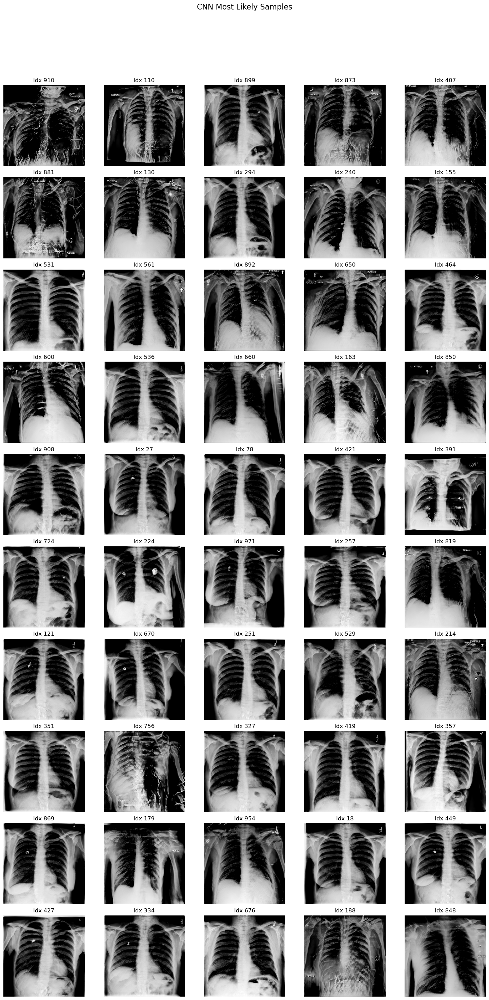

In [114]:
show_ranked_samples(samples, top_50, title="CNN Most Likely Samples")

In [115]:
ms_scorer = MahalanobisScorer(model=cnn, layer_name='layer4.1.bn1', device=device)

# Fit to state_dict
ms_scorer.fit_state_dict()

# Score samples
ms_scores = ms_scorer.score(samples)

# Rank - lower = more likely
ranked_indices_ms = np.argsort(ms_scores)

In [116]:
# All ranked output
import pandas as pd

df =  pd.DataFrame({
    'index': list(range(len(ms_scores))),
    'score': ms_scores
})
df = df.sort_values('score')
df

,index,score
364,364,259.930542
142,142,260.038452
744,744,260.974365
532,532,261.140137
642,642,261.899780
...,...,...
149,149,289.043335
55,55,289.245789
349,349,290.576233
682,682,290.737274


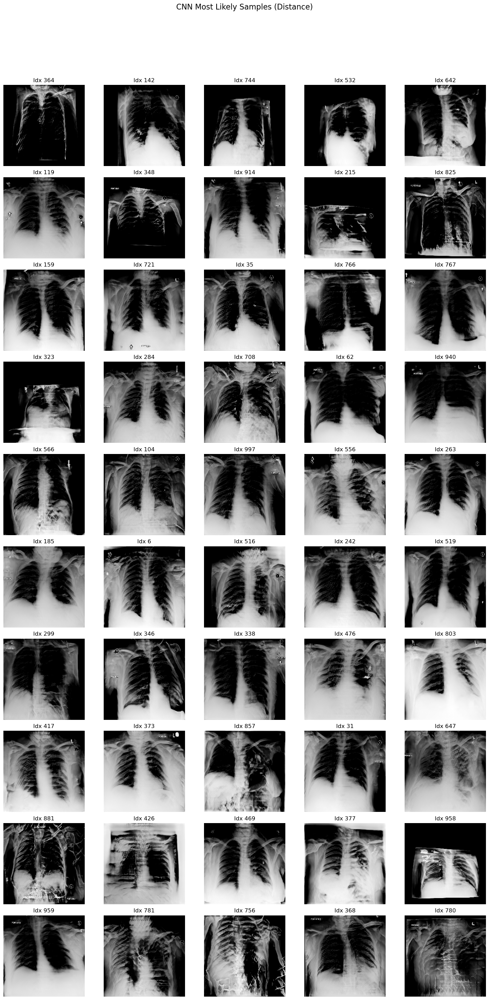

In [117]:
top_50_ms = ranked_indices_ms[:50]

show_ranked_samples(samples, top_50_ms, title="CNN Most Likely Samples (Distance)")

In [118]:
top_50 = set(top_50)
top_50_ms = set(top_50_ms)

overlap = top_50.intersection(top_50_ms)

print(f"Top-50 Overlap: {len(overlap)} images")
print("Indices:", sorted(overlap))

Top-50 Overlap: 2 images
Indices: [np.int64(756), np.int64(881)]


In [119]:
from PIL import Image 
import torchvision.transforms as transforms 
import json 
import os

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

def load_target_images(target_paths):
    target_imgs = []
    for path in target_paths:
        img = Image.open(path).convert('L')
        img = transform(img)
        target_imgs.append(img)
    return torch.stack(target_imgs)

# Target paths
image_root = 'data/CheXpert_Sample'
with open("target_models/images/cnn_images.json", "r") as f:
    data = json.load(f)
target_paths = [os.path.join(image_root, entry["Path"]) for entry in data]

target_images = load_target_images(target_paths)

In [120]:
# Load samples

samples = torch.load('recons/cnn/cnn_classes_cand2.pt', map_location='cpu')

overlap_indices = sorted(overlap)
overlap_samples = samples[overlap_indices]

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/4025371185.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  samples = torch.load('recons/cnn/cnn_classes_

In [121]:
# SSIM

from skimage.metrics import structural_similarity as ssim 
import numpy as np

def compute_ssim_tensor(img1, img2):
    if img1.shape[0] == 3:
        img1 = img1.mean(dim=0, keepdim=True) # average channels to grayscale
    if img2.shape[0] == 3:
        img2 = img2.mean(dim=0, keepdim=True)

    img1_np = img1.squeeze().cpu().numpy()
    img2_np = img2.squeeze().cpu().numpy()
    return ssim(img1_np, img2_np, data_range=1.0)

def find_best_ssim(samples, target_images):
    results = []
    for sample in samples:
        best_score = -1
        best_index = -1
        for i, target in enumerate(target_images):
            score = compute_ssim_tensor(sample, target)
            if score > best_score:
                best_score = score 
                best_index = i 
        results.append((best_index, best_score))
    return results

ssim_results = find_best_ssim(overlap_samples, target_images)

In [122]:
ssim_results

[(337, np.float64(0.1253606394872625)), (606, np.float64(0.09277280183836174))]

In [123]:
# Nearest neighbor in feature space

def to_rgb(tensor):
    if tensor.dim() == 2:
        tensor = tensor.unsqueeze(0)
    if tensor.size(0) == 1:
        return tensor.repeat(3, 1, 1)
    return tensor

def extract_features(model, images, layer_name='layer4', device='cpu'):
    model = model.eval().to(device)
    activations = {}

    def hook_fn(module, input, output):
        activations[layer_name] = output 

    for name, module in model.named_modules():
        if name == layer_name:
            module.register_forward_hook(hook_fn)
            break 

    feats = []
    with torch.no_grad():
        for img in images:
            img = to_rgb(img) # to RGB if needed
            img = img.unsqueeze(0).to(device)

            _ = model(img)
            feat = activations[layer_name].mean(dim=[2, 3]).squeeze(0).cpu()
            feats.append(feat)
    return torch.stack(feats)

def find_best_matches(feats_sample, feats_target):
    sim = F.cosine_similarity(feats_sample.unsqueeze(1), feats_target.unsqueeze(0), dim=-1)
    best_indices = sim.argmax(dim=1)
    best_scores = sim.max(dim=1).values 
    return list(zip(best_indices.tolist(), best_scores.tolist()))

In [124]:
# Extract features for samples
feats_sample = extract_features(cnn, overlap_samples, layer_name='layer4', device=device)

In [125]:
# Extract features for targets
feats_target = extract_features(cnn, target_images, layer_name='layer4', device=device)

In [126]:
feats_nn = find_best_matches(feats_sample, feats_target)

In [127]:
feats_nn

[(1159, 0.9635077118873596), (1510, 0.9137563109397888)]

In [128]:
nn_indices = [idx for idx, _ in feats_nn]
nn_scores = [score for _, score in feats_nn]

ssim_indices = [idx for idx, _ in ssim_results]
ssim_scores = [float(score) for _, score in ssim_results]

In [129]:
nn_indices

[1159, 1510]

In [130]:
import math

def show_recon_match_grid(recons, matches, ssim_scores=None, nn_scores=None, ncol=10):
    n = len(recons)
    ncols = ncol
    nrows = math.ceil(n / ncols) * 2

    fig, axs = plt.subplots(nrows, ncols, figsize=(2 * ncols, 2 * nrows))

    if nrows == 2:
        axs = axs.reshape(2, -1)

    for i in range(n):
        col = i % ncols
        row_group = i // ncols 
        row_recon = row_group * 2
        row_match = row_recon + 1

        recon = recons[i].detach().cpu().clamp(0, 1)
        match = matches[i].detach().cpu().clamp(0, 1)

        if recon.shape[0] == 1:
            recon_np = recon.squeeze(0).numpy()
        else:
            recon_np = recon.permute(1, 2, 0).numpy()

        match_np = match.squeeze(0).numpy()

        axs[row_recon, col].imshow(recon_np, cmap='gray')
        axs[row_recon, col].set_title("Reconstruction")
        axs[row_recon, col].axis('off')

        title = "Nearest Match"
        if ssim_scores is not None and nn_scores is not None:
            title += f"\nSSIM: {ssim_scores[i]:.3f}\nNN: {nn_scores[i]:.3f}"
        elif ssim_scores is not None:
            title += f"\nSSIM: {ssim_scores[i]:.3f}"
        elif nn_scores is not None:
            title += f"\nNN: {nn_scores[i]:.3f}"

        axs[row_match, col].imshow(match_np, cmap='gray')
        axs[row_match, col].set_title(title)
        axs[row_match, col].axis('off')

    for row in axs:
        for ax in row:
            if not ax.has_data():
                ax.axis('off')

    plt.tight_layout()
    plt.show()

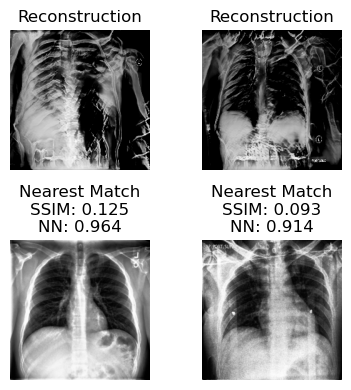

In [132]:
matched_targets = [target_images[i] for i in nn_indices]
show_recon_match_grid(
    recons=overlap_samples,
    matches=matched_targets,
    ssim_scores=ssim_scores,
    nn_scores=nn_scores,
    ncol=2
)

## Overfit CNN

In [7]:
from torchvision.models import resnet18, ResNet18_Weights
import torch
import torch.nn as nn

cnn_overfit = resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)
features = cnn_overfit.fc.in_features
cnn_overfit.fc = nn.Linear(features, 1)
cnn_overfit.load_state_dict(torch.load('target_models/models/chest2d_cnn_overfit_cpu.pt'))
cnn_overfit.eval().to(device)

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/416291377.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  cnn_overfit.load_state_dict(torch.load('target

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [ ]:
samples = torch.load('recons/cnn_overfit/cnn_overfit_cand.pt', map_location='cpu')

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/3040754570.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  samples = torch.load('recons/cnn_overfit/cnn_

In [79]:
scorer = ReverseLikelihoodScoreCNN(model=cnn_overfit, feature_layers=['layer4.1.conv2'], device=device)
scores = [scorer.score(img) for img in samples]
ranked_indices = np.argsort(scores)

In [10]:
# All ranked output
import pandas as pd

df =  pd.DataFrame({
    'index': list(range(len(scores))),
    'score': scores
})
df = df.sort_values('score')
df

,index,score
319,319,8.655478
472,472,8.679250
767,767,8.692028
168,168,8.699674
667,667,8.715328
...,...,...
379,379,12.490005
950,950,12.561333
976,976,13.157019
187,187,13.604424


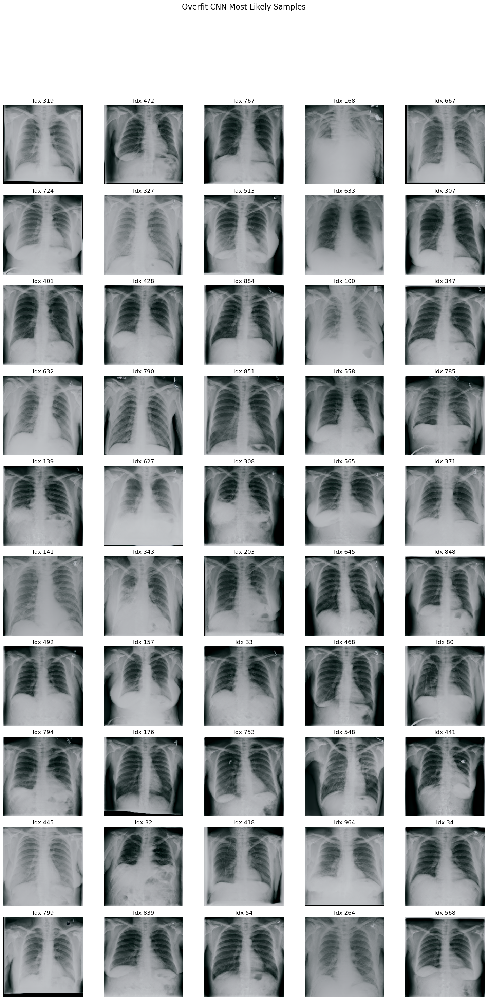

In [11]:
top_50 = ranked_indices[:50]

show_ranked_samples(samples, scores, top_50, title="Overfit CNN Most Likely Samples")

In [12]:
ms_scorer = MahalanobisScorer(model=cnn_overfit, layer_name='layer4.1.bn1', device=device)

# Fit to state_dict
ms_scorer.fit_state_dict()

# Score samples
ms_scores = ms_scorer.score(samples)

# Rank - lower = more likely
ranked_indices_ms = np.argsort(ms_scores)

In [13]:
# All ranked output
import pandas as pd

df =  pd.DataFrame({
    'index': list(range(len(ms_scores))),
    'score': ms_scores
})
df = df.sort_values('score')
df

,index,score
472,472,1871.716553
327,327,1871.988770
988,988,1873.592041
308,308,1873.885742
319,319,1874.283203
...,...,...
412,412,1957.135010
540,540,1959.813599
591,591,1960.337036
707,707,1963.158081


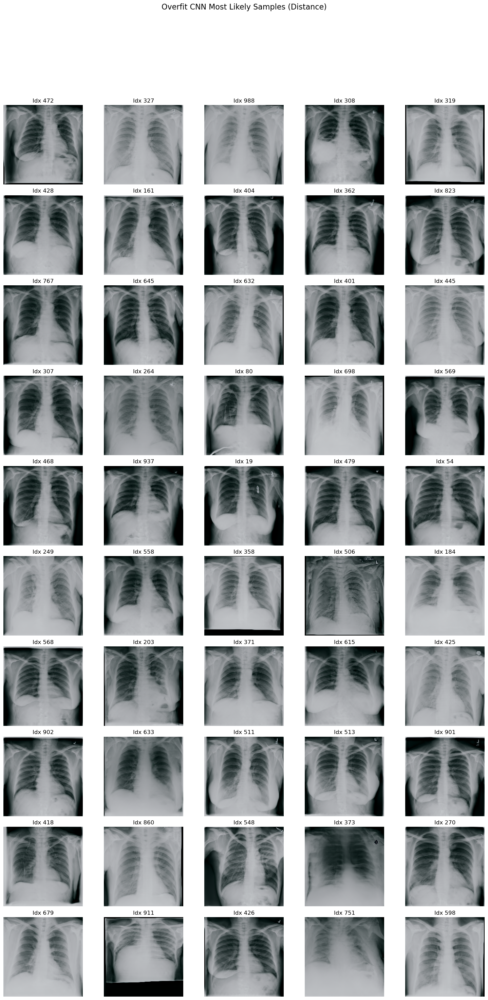

In [14]:
top_50_ms = ranked_indices_ms[:50]

show_ranked_samples(samples, ms_scores, top_50_ms, title="Overfit CNN Most Likely Samples (Distance)")

In [15]:
top_50 = set(top_50)
top_50_ms = set(top_50_ms)

overlap = top_50.intersection(top_50_ms)

print(f"Overfit CNN Top-30 Overlap: {len(overlap)} images")
print("Indices:", sorted(overlap))

Overfit CNN Top-30 Overlap: 23 images
Indices: [np.int64(54), np.int64(80), np.int64(203), np.int64(264), np.int64(307), np.int64(308), np.int64(319), np.int64(327), np.int64(371), np.int64(401), np.int64(418), np.int64(428), np.int64(445), np.int64(468), np.int64(472), np.int64(513), np.int64(548), np.int64(558), np.int64(568), np.int64(632), np.int64(633), np.int64(645), np.int64(767)]


Between overlapped images and real target model images, we compute Structural Similarity Index Measure (SSIM) and find the neareset target neighbor in feature space to validate the method.

In [16]:
from PIL import Image 
import torchvision.transforms as transforms 
import json 
import os

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

def load_target_images(target_paths):
    target_imgs = []
    for path in target_paths:
        img = Image.open(path).convert('L')
        img = transform(img)
        target_imgs.append(img)
    return torch.stack(target_imgs)

# Target paths
image_root = 'data/CheXpert_Sample'
with open("target_models/images/cnn_overfit_images.json", "r") as f:
    data = json.load(f)
target_paths = [os.path.join(image_root, entry["Path"]) for entry in data]

target_images = load_target_images(target_paths)

In [17]:
# Load samples

samples = torch.load('recons/cnn_overfit/cnn_overfit_cand.pt', map_location='cpu')

overlap_indices = sorted(overlap)
overlap_samples = samples[overlap_indices]

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/1048551066.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  samples = torch.load('recons/cnn_overfit/cnn_

In [18]:
# Compute SSIM

from skimage.metrics import structural_similarity as ssim 
import numpy as np

def compute_ssim_tensor(img1, img2):
    if img1.shape[0] == 3:
        img1 = img1.mean(dim=0, keepdim=True) # average channels to grayscale
    if img2.shape[0] == 3:
        img2 = img2.mean(dim=0, keepdim=True)

    img1_np = img1.squeeze().cpu().numpy()
    img2_np = img2.squeeze().cpu().numpy()
    return ssim(img1_np, img2_np, data_range=1.0)

def find_best_ssim(samples, target_images):
    results = []
    for sample in samples:
        best_score = -1
        best_index = -1
        for i, target in enumerate(target_images):
            score = compute_ssim_tensor(sample, target)
            if score > best_score:
                best_score = score 
                best_index = i 
        results.append((best_index, best_score))
    return results

In [19]:
# Nearest neighbor in feature space

def to_rgb(tensor):
    if tensor.dim() == 2:
        tensor = tensor.unsqueeze(0)
    if tensor.size(0) == 1:
        return tensor.repeat(3, 1, 1)
    return tensor

def extract_features(model, images, layer_name='layer4', device='cpu'):
    model = model.eval().to(device)
    activations = {}

    def hook_fn(module, input, output):
        activations[layer_name] = output 

    for name, module in model.named_modules():
        if name == layer_name:
            module.register_forward_hook(hook_fn)
            break 

    feats = []
    with torch.no_grad():
        for img in images:
            img = to_rgb(img) # to RGB if needed
            img = img.unsqueeze(0).to(device)

            _ = model(img)
            feat = activations[layer_name].mean(dim=[2, 3]).squeeze(0).cpu()
            feats.append(feat)
    return torch.stack(feats)

def find_best_matches(feats_sample, feats_target):
    sim = F.cosine_similarity(feats_sample.unsqueeze(1), feats_target.unsqueeze(0), dim=-1)
    best_indices = sim.argmax(dim=1)
    best_scores = sim.max(dim=1).values 
    return list(zip(best_indices.tolist(), best_scores.tolist()))

In [20]:
# SSIM
ssim_results = find_best_ssim(overlap_samples, target_images)

In [21]:
ssim_results

[(17, np.float64(0.41495469244922045)),
 (5, np.float64(0.3787185940116559)),
 (25, np.float64(0.442667700976142)),
 (25, np.float64(0.47467100041020693)),
 (17, np.float64(0.48417440103049425)),
 (25, np.float64(0.37900688114549325)),
 (5, np.float64(0.42067053292993967)),
 (5, np.float64(0.4381922656701906)),
 (17, np.float64(0.48985380498885533)),
 (31, np.float64(0.4328563598264104)),
 (9, np.float64(0.4049831912829742)),
 (25, np.float64(0.4638150371374932)),
 (5, np.float64(0.4626319025259846)),
 (17, np.float64(0.35274909927567255)),
 (5, np.float64(0.4162915272160695)),
 (25, np.float64(0.4300338909607548)),
 (5, np.float64(0.3895887504139487)),
 (17, np.float64(0.45870750369839)),
 (5, np.float64(0.3990835684817595)),
 (5, np.float64(0.4689138208561559)),
 (17, np.float64(0.5306811929757103)),
 (25, np.float64(0.3628526904912425)),
 (17, np.float64(0.4797241211290131))]

In [22]:
# Extract features for samples
feats_sample = extract_features(cnn_overfit, overlap_samples, layer_name='layer4', device=device)

In [23]:
# Extract features for targets
feats_target = extract_features(cnn_overfit, target_images, layer_name='layer4', device=device)

In [24]:
# Feature NN
feats_nn = find_best_matches(feats_sample, feats_target)

In [25]:
feats_nn

[(2, 0.826248049736023),
 (2, 0.7994869947433472),
 (2, 0.7952147722244263),
 (2, 0.7646744251251221),
 (0, 0.8256614208221436),
 (0, 0.8180357813835144),
 (34, 0.7601426243782043),
 (15, 0.7787063121795654),
 (5, 0.788083016872406),
 (2, 0.8127866983413696),
 (0, 0.8064466714859009),
 (2, 0.816926896572113),
 (4, 0.7831432819366455),
 (0, 0.8107829093933105),
 (2, 0.8191298246383667),
 (31, 0.8006075620651245),
 (16, 0.8039753437042236),
 (17, 0.7890921235084534),
 (0, 0.8092195391654968),
 (17, 0.7825504541397095),
 (17, 0.7689698338508606),
 (2, 0.8240379095077515),
 (2, 0.8102304935455322)]

In [98]:
import math

def show_recon_match_grid(recons, matches, ssim_scores=None, nn_scores=None, ncol=10):
    n = len(recons)
    ncols = ncol
    nrows = math.ceil(n / ncols) * 2

    fig, axs = plt.subplots(nrows, ncols, figsize=(2 * ncols, 2 * nrows))

    if nrows == 2:
        axs = axs.reshape(2, -1)

    for i in range(n):
        col = i % ncols
        row_group = i // ncols 
        row_recon = row_group * 2
        row_match = row_recon + 1

        recon = recons[i].detach().cpu().clamp(0, 1)
        match = matches[i].detach().cpu().clamp(0, 1)

        if recon.shape[0] == 1:
            recon_np = recon.squeeze(0).numpy()
        else:
            recon_np = recon.permute(1, 2, 0).numpy()

        match_np = match.squeeze(0).numpy()

        axs[row_recon, col].imshow(recon_np, cmap='gray')
        axs[row_recon, col].set_title("Reconstruction")
        axs[row_recon, col].axis('off')

        title = "Nearest Match"
        if ssim_scores is not None and nn_scores is not None:
            title += f"\nSSIM: {ssim_scores[i]:.3f}\nNN: {nn_scores[i]:.3f}"
        elif ssim_scores is not None:
            title += f"\nSSIM: {ssim_scores[i]:.3f}"
        elif nn_scores is not None:
            title += f"\nNN: {nn_scores[i]:.3f}"

        axs[row_match, col].imshow(match_np, cmap='gray')
        axs[row_match, col].set_title(title)
        axs[row_match, col].axis('off')

    for row in axs:
        for ax in row:
            if not ax.has_data():
                ax.axis('off')

    plt.tight_layout()
    plt.show()

In [27]:
nn_indices = [idx for idx, _ in feats_nn]
nn_scores = [score for _, score in feats_nn]

ssim_indices = [idx for idx, _ in ssim_results]
ssim_scores = [float(score) for _, score in ssim_results]

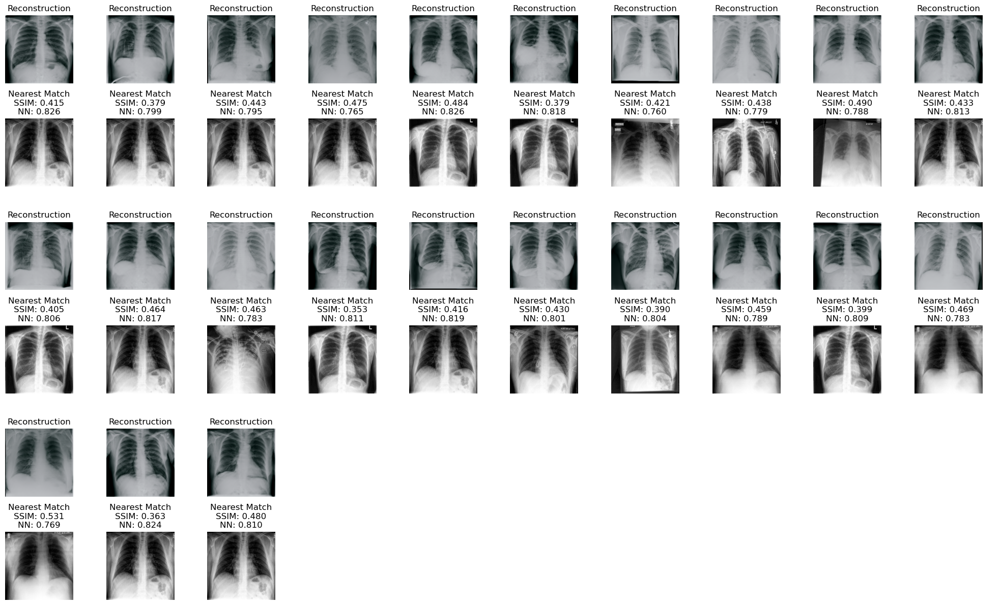

In [33]:
matched_targets = [target_images[i] for i in nn_indices]
show_recon_match_grid(
    recons=overlap_samples,
    matches=matched_targets,
    ssim_scores=ssim_scores,
    nn_scores=nn_scores,
    ncol=10
)

## ViT

In [29]:
import torch.nn.functional as F

class ReverseLikelihoodScoreViT:
    def __init__(self, model, feature_layers, device='cpu'):
        self.model = model.eval().to(device)
        self.feature_layers = feature_layers
        self.device = device
        self.activations = {}

        # Register forward hooks 
        self._register_hooks()

    def _register_hooks(self):
        for name, module in self.model.named_modules():
            if name in self.feature_layers:
                module.register_forward_hook(self._make_hook(name))

    def _make_hook(self, name):
        def hook(module, input, output):
            self.activations[name] = output.detach()
        return hook

    def score(self, sample, w_cls=1.0, w_ln=1.0, w_logits=1.0):
        self.activations.clear()
        self.model.eval()
        loss = 0.0

        with torch.no_grad():
            sample = sample.unsqueeze(0).to(self.device)
            logits = self.model(sample)

            # CLS token
            if 'encoder' in self.activations:
                cls_token = self.activations['encoder'][:, 0, :]
                loss += w_cls * (cls_token ** 2).mean()

            # LayerNorm stats
            if 'encoder.encoder_layer_5.ln_1' in self.activations:
                ln_out = self.activations['encoder.encoder_layer_5.ln_1']
                mean_ln = ln_out.mean(dim=0)
                var_ln = ln_out.var(dim=0, unbiased=False)
                loss += w_ln * ((mean_ln ** 2).mean() + ((var_ln - 1) ** 2).mean())

            # Logits
            probs = F.softmax(logits, dim=1)
            max_conf = probs.max(dim=1)[0]
            loss -= w_logits * max_conf.mean() # encourage confident predictions

        return loss.item()

In [30]:
from scipy.linalg import inv
import numpy as np

class MahalanobisScorerViT:
    def __init__(self, model, layer_name, device='cpu'):
        self.model = model.eval().to(device)
        self.layer_name = layer_name 
        self.device = device 

        self.mu = None 
        self.sigma = None 
        self.inv_cov = None
        self.activations = {}
        
        # Register forward hooks
        self._register_hooks()

    def _register_hooks(self):
        for name, module in self.model.named_modules():
            if name == self.layer_name:
                module.register_forward_hook(self._make_hook())
                return
        raise ValueError(f"Layer {self.layer_name} not found in model.")
        
    def _make_hook(self):
        def hook(module, input, output):
            self.activations[self.layer_name] = output.detach()
        return hook 
    
    def _extract_features(self, tensor_batch):
        feats = []
        self.model.eval()
        with torch.no_grad():
            for img in tensor_batch:
                self.activations.clear()
                img = img.unsqueeze(0).to(self.device)
                _ = self.model(img)
                act = self.activations[self.layer_name]

                if act.dim() == 3:
                    feat = act.mean(dim=1).squeeze(0).cpu().numpy()
                else:
                    feat = act.squeeze(0).cpu().numpy()

                feats.append(feat)
        return np.vstack(feats)
    
    def fit_state_dict(self):
        for name, module in self.model.named_modules():
            if name == self.layer_name and isinstance(module, nn.LayerNorm):
                self.mu = module.bias.detach().cpu().numpy()
                var = module.weight.detach().cpu().numpy()
                self.sigma = np.diag(var + 1e-6)
                self.inv_cov = np.linalg.inv(self.sigma)
                return 
            
    def fit_ref(self, ref_batch):
        feats = self._extract_features(ref_batch)
        self.mu = feats.mean(axis=0)
        self.sigma = np.cov(feats, rowvar=False) + 1e-6 * np.eye(feats.shape[1])
        self.inv_cov = inv(self.sigma)

    def score(self, img_batch):
        scores = []
        feats = self._extract_features(img_batch)
        for f in feats:
            diff = f - self.mu 
            m_dist = diff @ self.inv_cov @ diff.T
            scores.append(m_dist)
        return np.array(scores)

In [31]:
# Load model
from torchvision.models import vit_b_16, ViT_B_16_Weights
import torch.nn as nn 

vit = vit_b_16(weights=ViT_B_16_Weights.DEFAULT)
in_features = vit.heads.head.in_features
vit.heads.head = nn.Linear(in_features, 1)
vit.load_state_dict(torch.load('target_models/models/chest2d_vit_cpu.pt'))
vit.eval().to(device)

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/3283771644.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  vit.load_state_dict(torch.load('target_models

VisionTransformer(
  (conv_proj): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
  (encoder): Encoder(
    (dropout): Dropout(p=0.0, inplace=False)
    (layers): Sequential(
      (encoder_layer_0): EncoderBlock(
        (ln_1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (self_attention): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
        )
        (dropout): Dropout(p=0.0, inplace=False)
        (ln_2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU(approximate='none')
          (2): Dropout(p=0.0, inplace=False)
          (3): Linear(in_features=3072, out_features=768, bias=True)
          (4): Dropout(p=0.0, inplace=False)
        )
      )
      (encoder_layer_1): EncoderBlock(
        (ln_1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (self_a

In [32]:
samples = torch.load('recons/vit/vit_cand.pt', map_location='cpu')

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/234180940.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  samples = torch.load('recons/vit/vit_cand.pt',

In [33]:
feature_layers = ['encoder', 'encoder.encoder_layer_5.ln_1']

scorer = ReverseLikelihoodScoreViT(model=vit, feature_layers=feature_layers, device=device)
scores = [scorer.score(img) for img in samples]
sorted_indices = np.argsort(scores)

In [34]:
# All ranked output
import pandas as pd

df =  pd.DataFrame({
    'index': list(range(len(scores))),
    'score': scores
})
df = df.sort_values('score')
df

,index,score
991,991,-0.830500
201,201,-0.825597
172,172,-0.824817
193,193,-0.824295
340,340,-0.824289
...,...,...
771,771,-0.675149
600,600,-0.674257
840,840,-0.671747
352,352,-0.670096


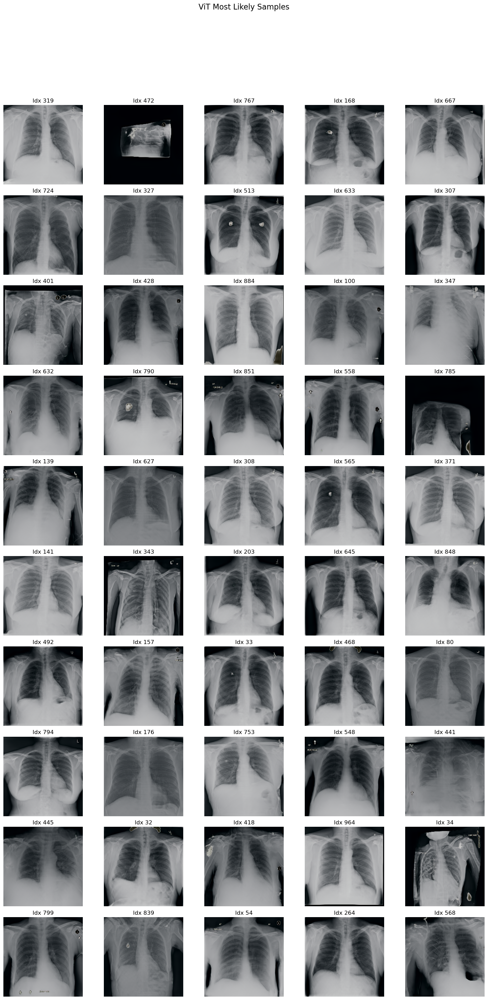

In [35]:
top_50 = ranked_indices[:50]

show_ranked_samples(samples, scores, top_50, title="ViT Most Likely Samples")

In [36]:
ms_scorer = MahalanobisScorerViT(model=vit, layer_name='encoder.layers.encoder_layer_11.ln_1', device=device)

# Fit to state_dict
ms_scorer.fit_state_dict()

# Score samples
ms_scores = ms_scorer.score(samples)

# Rank - lower = more likely
ranked_indices_ms = np.argsort(ms_scores)

In [37]:
# All ranked output
import pandas as pd

df =  pd.DataFrame({
    'index': list(range(len(ms_scores))),
    'score': ms_scores
})
df = df.sort_values('score')
df

,index,score
227,227,76.028458
246,246,76.068054
624,624,76.272583
175,175,76.370972
281,281,77.667854
...,...,...
876,876,102.976883
138,138,103.640579
779,779,104.151489
633,633,104.213943


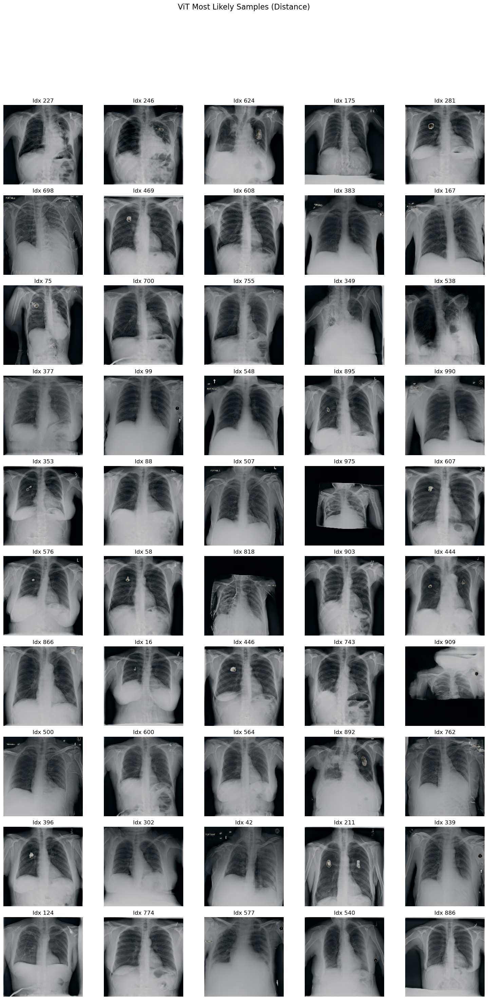

In [38]:
top_50_ms = ranked_indices_ms[:50]

show_ranked_samples(samples, ms_scores, top_50_ms, title="ViT Most Likely Samples (Distance)")

In [39]:
top_50 = set(top_50)
top_50_ms = set(top_50_ms)

overlap = top_50.intersection(top_50_ms)

print(f"ViT Top-50 Overlap: {len(overlap)} images")
print("Indices:", sorted(overlap))

ViT Top-50 Overlap: 1 images
Indices: [np.int64(548)]


In [40]:
from PIL import Image 
import torchvision.transforms as transforms 
import json 
import os

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

def load_target_images(target_paths):
    target_imgs = []
    for path in target_paths:
        img = Image.open(path).convert('L')
        img = transform(img)
        target_imgs.append(img)
    return torch.stack(target_imgs)

# Target paths
image_root = 'data/CheXpert_Sample'
with open("target_models/images/vit_images.json", "r") as f:
    data = json.load(f)
target_paths = [os.path.join(image_root, entry["Path"]) for entry in data]

target_images = load_target_images(target_paths)

In [41]:
# Load samples

samples = torch.load('recons/vit/vit_cand.pt', map_location='cpu')

overlap_indices = sorted(overlap)
overlap_samples = samples[overlap_indices]

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/60127172.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  samples = torch.load('recons/vit/vit_cand.pt', 

In [42]:
# SSIM
ssim_results = find_best_ssim(overlap_samples, target_images)

In [43]:
ssim_results

[(2965, np.float64(0.5010766312804249))]

In [44]:
def extract_vit_features(model, images, layer_name='encoder.ln', device='cpu'):
    model = model.eval().to(device)
    activations = {}

    def hook_fn(module, input, output):
        activations[layer_name] = output 

    for name, module in model.named_modules():
        if name == layer_name:
            module.register_forward_hook(hook_fn)
            break 

    feats = []
    with torch.no_grad():
        for img in images:
            img = to_rgb(img) # to RGB if needed
            img = img.unsqueeze(0).to(device)

            _ = model(img)
            feat = activations[layer_name].squeeze(0)
            if feat.ndim == 2:
                feat = feat[1:].mean(dim=0) # if output is sequence, average tokens
            feats.append(feat)
            
    return torch.stack(feats)

In [45]:
# Extract features for samples
feats_sample = extract_vit_features(vit, overlap_samples, layer_name='encoder.ln', device=device)

In [46]:
# Extract features for targets
feats_target = extract_vit_features(vit, target_images, layer_name='encoder.ln', device=device)

In [47]:
# Feature NN
feats_nn = find_best_matches(feats_sample, feats_target)

In [48]:
nn_indices = [idx for idx, _ in feats_nn]
nn_scores = [score for _, score in feats_nn]

ssim_indices = [idx for idx, _ in ssim_results]
ssim_scores = [float(score) for _, score in ssim_results]

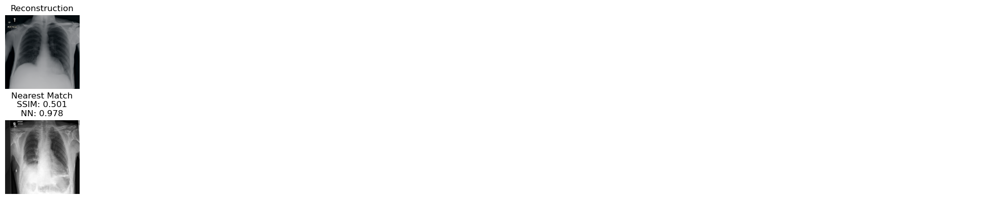

In [57]:
matched_targets = [target_images[i] for i in nn_indices]
show_recon_match_grid(
    recons=overlap_samples,
    matches=matched_targets,
    ssim_scores=ssim_scores,
    nn_scores=nn_scores,
    ncol=10
)

## Overfit ViT

In [50]:
# Load model
from torchvision.models import vit_b_16, ViT_B_16_Weights

vit_overfit = vit_b_16(weights=ViT_B_16_Weights.DEFAULT)
in_features = vit_overfit.heads.head.in_features
vit_overfit.heads.head = nn.Linear(in_features, 1)
vit_overfit.load_state_dict(torch.load('target_models/models/chest2d_vit_overfit_cpu.pt'))
vit_overfit.eval().to(device)

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/1437096055.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  vit_overfit.load_state_dict(torch.load('targe

VisionTransformer(
  (conv_proj): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
  (encoder): Encoder(
    (dropout): Dropout(p=0.0, inplace=False)
    (layers): Sequential(
      (encoder_layer_0): EncoderBlock(
        (ln_1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (self_attention): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
        )
        (dropout): Dropout(p=0.0, inplace=False)
        (ln_2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (0): Linear(in_features=768, out_features=3072, bias=True)
          (1): GELU(approximate='none')
          (2): Dropout(p=0.0, inplace=False)
          (3): Linear(in_features=3072, out_features=768, bias=True)
          (4): Dropout(p=0.0, inplace=False)
        )
      )
      (encoder_layer_1): EncoderBlock(
        (ln_1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (self_a

In [51]:
samples = torch.load('recons/vit_overfit/vit_overfit_cand.pt', map_location='cpu')

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/3756302433.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  samples = torch.load('recons/vit_overfit/vit_

In [52]:
feature_layers = ['encoder', 'encoder.encoder_layer_5.ln_1']

scorer = ReverseLikelihoodScoreViT(model=vit_overfit, feature_layers=feature_layers, device=device)
scores = [scorer.score(img) for img in samples]
sorted_indices = np.argsort(scores)

In [53]:
# All ranked output
import pandas as pd

df =  pd.DataFrame({
    'index': list(range(len(scores))),
    'score': scores
})
df = df.sort_values('score')
df

,index,score
88,88,-0.718403
123,123,-0.706826
521,521,-0.704228
398,398,-0.700491
274,274,-0.699744
...,...,...
22,22,-0.467321
75,75,-0.466128
786,786,-0.463857
49,49,-0.459875


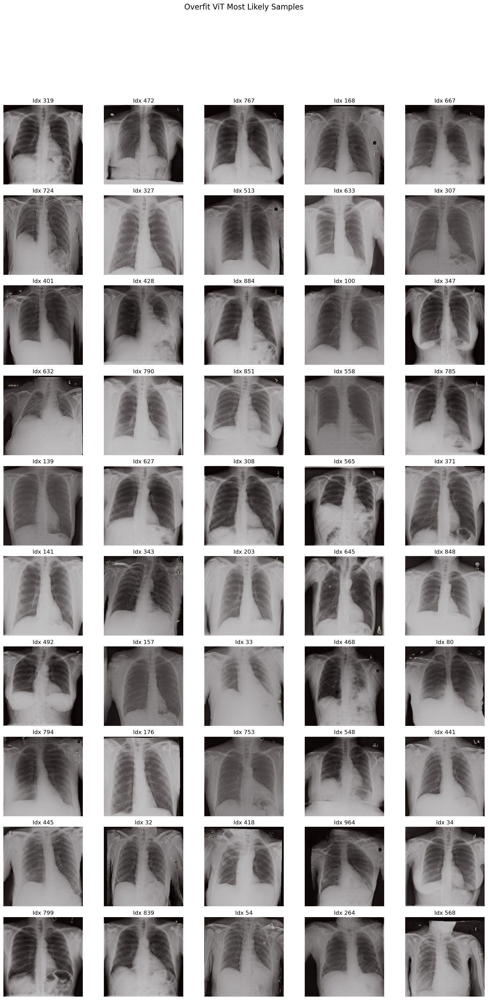

In [54]:
top_50 = ranked_indices[:50]

show_ranked_samples(samples, scores, top_50, title="Overfit ViT Most Likely Samples")

In [55]:
ms_scorer = MahalanobisScorerViT(model=vit_overfit, layer_name='encoder.layers.encoder_layer_11.ln_1', device=device)

# Fit to state_dict
ms_scorer.fit_state_dict()

# Score samples
ms_scores = ms_scorer.score(samples)

# Rank - lower = more likely
ranked_indices_ms = np.argsort(ms_scores)

In [56]:
# All ranked output
import pandas as pd

df =  pd.DataFrame({
    'index': list(range(len(ms_scores))),
    'score': ms_scores
})
df = df.sort_values('score')
df

,index,score
886,886,44.390087
344,344,44.703400
653,653,45.328865
191,191,46.048004
984,984,46.116833
...,...,...
559,559,71.826080
991,991,72.347412
312,312,72.426041
996,996,74.417114


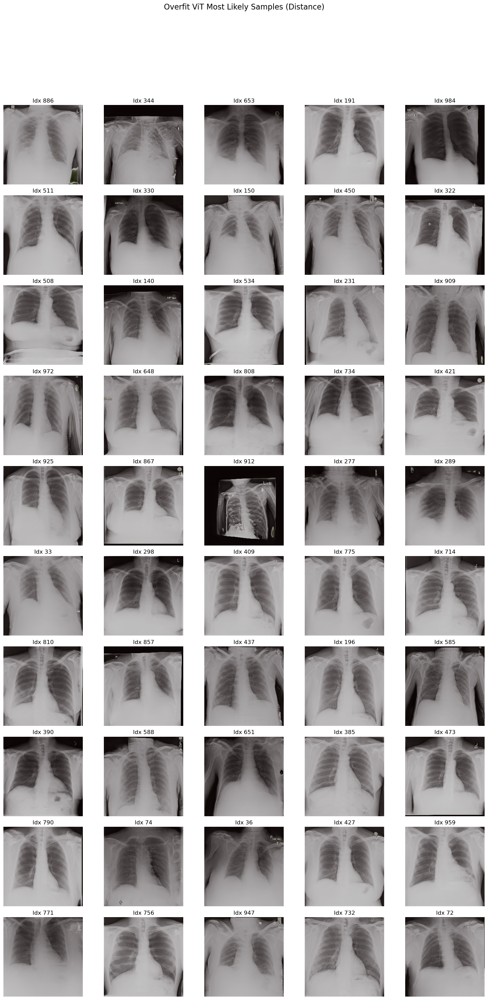

In [57]:
top_50_ms = ranked_indices_ms[:50]

show_ranked_samples(samples, ms_scores, top_50_ms, title="Overfit ViT Most Likely Samples (Distance)")

In [58]:
top_50 = set(top_50)
top_50_ms = set(top_50_ms)

overlap = top_50.intersection(top_50_ms)

print(f"Overfit ViT Top-50 Overlap: {len(overlap)} images")
print("Indices:", sorted(overlap))

Overfit ViT Top-50 Overlap: 2 images
Indices: [np.int64(33), np.int64(790)]


In [59]:
from PIL import Image 
import torchvision.transforms as transforms 
import json 
import os

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

def load_target_images(target_paths):
    target_imgs = []
    for path in target_paths:
        img = Image.open(path).convert('L')
        img = transform(img)
        target_imgs.append(img)
    return torch.stack(target_imgs)

# Target paths
image_root = 'data/CheXpert_Sample'
with open("target_models/images/vit_overfit_images.json", "r") as f:
    data = json.load(f)
target_paths = [os.path.join(image_root, entry["Path"]) for entry in data]

target_images = load_target_images(target_paths)

In [60]:
# Load samples

samples = torch.load('recons/vit_overfit/vit_overfit_cand.pt', map_location='cpu')

overlap_indices = sorted(overlap)
overlap_samples = samples[overlap_indices]

/var/folders/3w/wbtzr_qn1vsd0q77hb8f34tr0000gn/T/ipykernel_81712/2016595929.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  samples = torch.load('recons/vit_overfit/vit_

In [61]:
# SSIM
ssim_results = find_best_ssim(overlap_samples, target_images)

In [62]:
ssim_results

[(3, np.float64(0.5320244178397812)), (70, np.float64(0.4734809203043468))]

In [63]:
# Extract features for samples
feats_sample = extract_vit_features(vit_overfit, overlap_samples, layer_name='encoder.ln', device=device)

In [64]:
# Extract features for targets
feats_target = extract_vit_features(vit_overfit, target_images, layer_name='encoder.ln', device=device)

In [65]:
# Feature NN
feats_nn = find_best_matches(feats_sample, feats_target)

In [66]:
feats_nn

[(59, 0.8603898286819458), (8, 0.903243362903595)]

In [67]:
nn_indices = [idx for idx, _ in feats_nn]
nn_scores = [score for _, score in feats_nn]

ssim_indices = [idx for idx, _ in ssim_results]
ssim_scores = [float(score) for _, score in ssim_results]

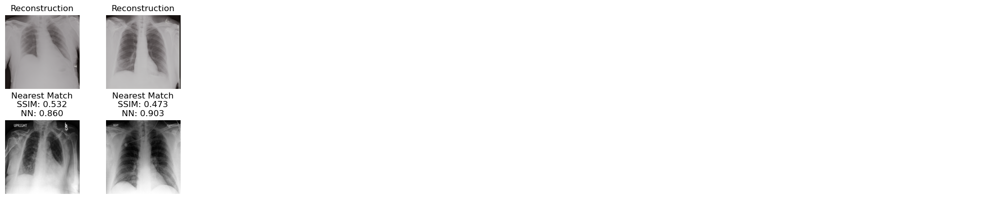

In [76]:
matched_targets = [target_images[i] for i in nn_indices]
show_recon_match_grid(
    recons=overlap_samples,
    matches=matched_targets,
    ssim_scores=ssim_scores,
    nn_scores=nn_scores,
    ncol=10
)